In [1]:
import numpy as np
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy import linalg
#from scipy import stats

from numpy.linalg import inv

from IPython.display import Image
from matplotlib import image
from matplotlib import pyplot as plt
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

# SVD: review

## The decompostion (factorization)
$$ A = U \Sigma V^T $$

- $A$ is a $m \times n$ matrix with rank $r$
- $U$ is an $m \times m$ orthogonal matrix (columns $u_i$ are left singular vectors)
    - First $r$ columns are a basis for $C(A)$
    - Trailing $m - r$ columns are a basis for $N(A^T)$
- $V$ is an $n \times n$ orthogonal matrix (columns $v_i$ are right singular vectors)
    - First $r$ columns are a basis for $C(A^T)$
    - Trailing $n - r$ columns are a basis for $N(A)$
- $\Sigma$ is an $m \times n$ diaognal matrix with entries $\Sigma_{ii} = \sigma_i$ (singular values)
    - $\sigma_1 \ge \sigma_2 \ge \dots \ge \sigma_r$, $\sigma_{r+1} = \sigma_{r+2} = \dots = 0$
    - Ordering of singular vectors matches that of singular values

## Sum of rank-1 matrices
$$ A = \sum_{i=1}^r \sigma_i \mathbf{u}_i \mathbf{v}_i^T$$

Role of singular vectors in $C(A)$ and $C(A^T)$ is explicit.

Likewise for the orthogonal null spaces $N(A^T)$ and $N(A)$.

## Relation to symmetric positive semi-definite matrices
$u_i$ is an eigenvector of the symmetric positive semi-definite matrix $AA^T$ with eigenvalue $\sigma_i^2$

$v_i$ is an eigenvector of the symmetric positive semi-definite matrix $A^T A$ with eigenvalue $\sigma_i^2$

## "Stretching" inequalities

Follow directly from properties of positive semi-definite matrices (Lecture 23)
$$ \max_{x} \frac{\|Ax\|^2}{\|x\|^2} = \sigma_1^2 $$
$$ \min_{x} \frac{\|Ax\|^2}{\|x\|^2} = \sigma_n^2 $$

If $A$ is square, we can take $x$ to be an eigenvector and add inequalities:
$$ \max_{x} \frac{\|Ax\|^2}{\|x\|^2} = \sigma_1^2 \ge |\lambda_{max}(A)|^2$$
$$ \min_{x} \frac{\|Ax\|^2}{\|x\|^2} = \sigma_n^2 \le |\lambda_{min}(A)|^2$$
with equality if $A$ is symmetric, in which case eigenvectors and singular vectors are the same. 

Similar situation when $A$ is *normal* (commutes with its transpose, e.g., skew-symmetric)

## Moore-Penrose pseudo-inverse
The pseudo-inverse of $A$ is
$$ A^+ = V \Sigma^+ U^T = \sum_{i=1}^r \frac{1}{\sigma_i} \mathbf{v}_i \mathbf{u}_i^T$$
$\Sigma^+$ of a diagonal matrix means take the transpose and invert the non-zero diagonal entries.

If $A^{-1}$ exists, $A^{-1} = A^+$.

The solution of $Ax = b$ is (in many senses), $x = A^+ b$
- The unique solution when $A$ is square and invertible
- The shortest solution when the solution exists but is not unique 
- The least-squares solution when no solution exists and the columns of $A$ are linearly independent
- The shortest least-squares solution when no solution exists and the columns of $A$ are not linearly independent

## The economy SVD
The **economy (compact, thin) SVD** of an $m\times n$ matrix $A$ of rank $r$ is  
$$
A = U_r \Sigma_r V_r^T = \sum_{i=1}^r \sigma_i \mathbf{u}_i \mathbf{v}_i^T,
$$
where $U_r$ is $m\times r$, $V_r$ is $n\times r$, and $\Sigma_r$ is $r\times r$ diagonal with 
$\sigma_1,\dots,\sigma_r > 0$.

In contrast, the full SVD uses
$$
A = U \Sigma V^T,
$$
with $U$ of size $m\times m$, $V$ of size $n\times n$, and $\Sigma$ padded with zeros outside the top $r\times r$ block.  
The extra singular vectors span the left nullspace and nullspace of $A$, but do not contribute to the nonzero singular structure.

**Advantage 1: Computational efficiency**

The economy SVD stores and computes only the $r$ singular directions, which reduces storage and operations.  
For large sparse or low-rank matrices, this is a major savings.

**Advantage 2: Simpler pseudoinverse**

With the economy SVD,
$$
A^{+} = V_r \Sigma_r^{-1} U_r^{T}.
$$
Only the nonzero singular values in the *square* matrix $\Sigma_r$ are inverted.  

**Advantage 3: Projection matrices become transparent**

Using the economy SVD,
$$
AA^{+} = U_r U_r^{T} = \sum_{i=1}^r \mathbf{u}_i \mathbf{u}_i^T
$$

and

$$
A^{+}A = V_r V_r^{T} = \sum_{i=1}^r \mathbf{v}_i \mathbf{v}_i^T
$$ 
which are immediately recognizable as orthogonal projectors because $U_r$ and $V_r$ have orthonormal columns.

Also sum of 1D projections. 

In full SVD form, one would write

$$
AA^{+} = U 
\begin{bmatrix} I_r & 0 \\ 0 & 0 \end{bmatrix}
U^{T},
$$
which is less transparent.

# Best rank-k approximation and Frobenious norm

The best rank-$k$ approximation of $A$ is 
$$ A_k = \sum_{i=1}^k \sigma_i \mathbf{u}_i \mathbf{v}_i^T$$
where one meaning of best is that the Frobenious norm of the difference $A - A_k$ is minimized.

What is the Frobenious norm? Notation is 
$$ \| A - A_k \|_F^2$$
and definition is
$$ \|B\|_F^2 = \sum_{i=1}^m \sum_{j=1}^n B_{ij}^2 = \text{trace} (B^T B) = \sum_{j=1}^n \|\mathbf{b}_j\|^2$$
where $\mathbf{b}_j$ is the $j$-th column of $B$. 

The Frobenious norm (squared) of a matrix is
- The sum of the squares of its entries (just like the norm of a matrix). Explicit but not matrix-y?
- The sum of the squared lengths of its columns (or rows). Better
- The trace of the product of the matrix with its tranpose. Very matrix-y!

Where does the last one come from?

The $(i,j)$ entry of $B^T B$ is
$$
(B^T B)_{ij} = \sum_{k=1}^m B_{ki} B_{kj},
$$
which is the dot product of column $i$ and column $j$ of $B$.

In particular, the diagonal entries are
$$
(B^T B)_{ii} = \sum_{k=1}^m (B_{ki})^2.
$$

Summing over all $i$:
$$
\sum_{i=1}^n (B^T B)_{ii}
= \sum_{i=1}^n \sum_{k=1}^m (B_{ki})^2
= \|B\|_F^2.
$$

Thus,
$$
\boxed{\|B\|_F^2 = \operatorname{trace}(B^T B)}.
$$

# Best rank-k approximation

Let
$$
A = \sum_{i=1}^r \sigma_i u_i v_i^T
$$
be the SVD of $A$. The best rank-$k$ approximation of $A$ is (Eckart–Young theorem):
$$
A_k = \sum_{i=1}^k \sigma_i u_i v_i^T.
$$

The approximation error is
$$
\|A - A_k\|_F^2 
= \left\| \sum_{i=k+1}^r \sigma_i u_i v_i^T \right\|_F^2.
$$

Since singular vectors are orthonormal and orthogonal to each other,
$$
\|A - A_k\|_F^2 
= \sum_{i=k+1}^r \sigma_i^2.
$$

Thus, keeping the largest $k$ singular values yields the best rank-$k$ approximation in Frobenius norm.

The trailing singular values determine the approximation error.

## Sketch of proof
## 1. Orthogonal invariance of the Frobenius norm

For any orthogonal matrix $Q$ of compatible size,
$$
\|QB\|_F = \|BQ\|_F = \|B\|_F.
$$

This follows from the fact that
$$
\operatorname{tr}(B^T B) = \operatorname{tr}( (QB)^T (QB) )
= \operatorname{tr}( B^T Q^T Q B)
= \operatorname{tr}(B^T B).
$$

---

## 2. Diagonal case without loss of generality

$$
\|A - A^*\|^2_F = \|U \Sigma V^T - A^*\|^2_F = \|\Sigma - U^T A^* V\|^2_F = \sum_{i=1}^m \sum_{j=1}^n
$$

Call $U^T A^* V = D + B$ where $D$ is diagonal and $B$ has zeros on the diagonal. Then,
$$
\|\Sigma - U^T A^* V\|^2_F = \sum_{i=1}^m \sum_{j=1}^n B_{ij}^2 + \sum_{i=1}^m (\Sigma_{ii} - D_{ii})^2
$$

- Any off-diagonal elements in $U^T A^* V$ (i.e., $B$ terms) make the difference larger
- $D$ should cancel out the biggest entries in $\Sigma$
- If $D$ is rank-$k$ (number of pivots), it has $k$ non-zero diagonal entries
- Choose $D = \Sigma_k$, which gives $A^* = A_k = U_k \Sigma_k V_k^T$

# SVD applications

- Data compression/PCA
- Total least squares (TLS)


Data often come in the form of a matrix (spreadsheet) or can be reshaped into that form.

The SVD is
$$ A = \sum_{i=1}^r \sigma_i \mathbf{u}_i \mathbf{v}_i^T $$ 

and the "best" rank-$k$ approximation of $A$ is
$$ A_k = \sum_{i=1}^k \sigma_i \mathbf{u}_i \mathbf{v}_i^T $$ 

where $k<r$ makes sense.

# Example:   Image compression 
(taken from APMA 4300 and matlab)

How does this work in practice?

## The original Matrix (From Durer's Melancholia)

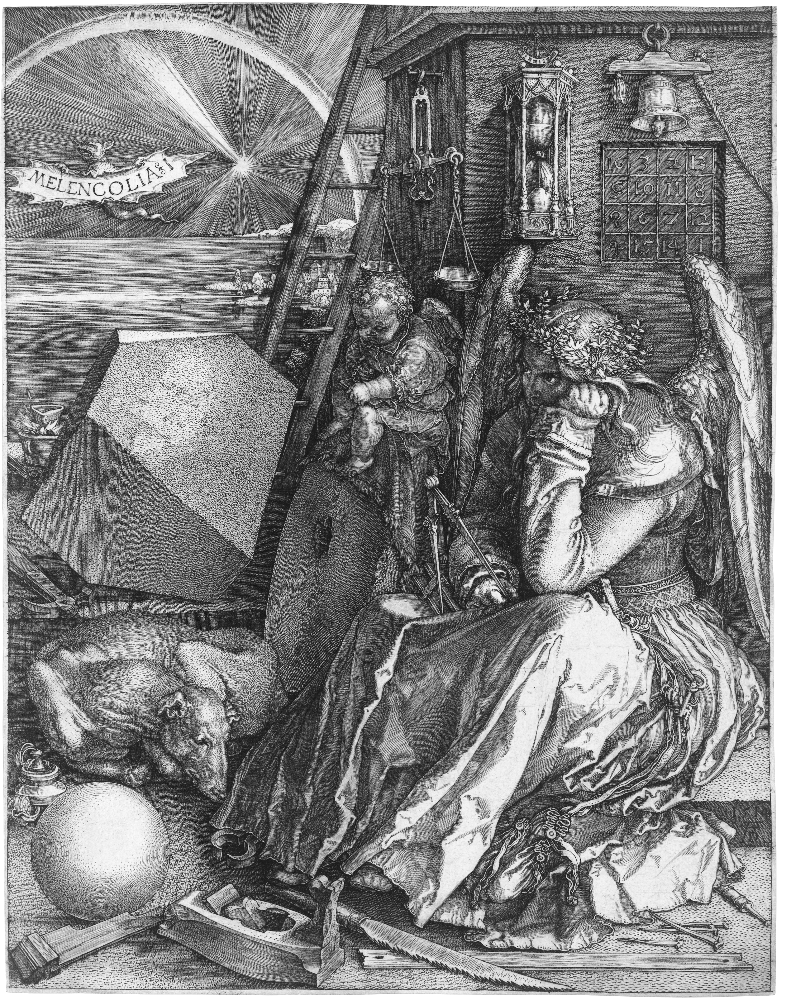

In [2]:
Image(filename='images/Durer_Melancholia_I.jpg', width=500) 

In [3]:
data = image.imread('images/melancholia-magic-square.png')
m, n = data.shape

453x457 pixel image


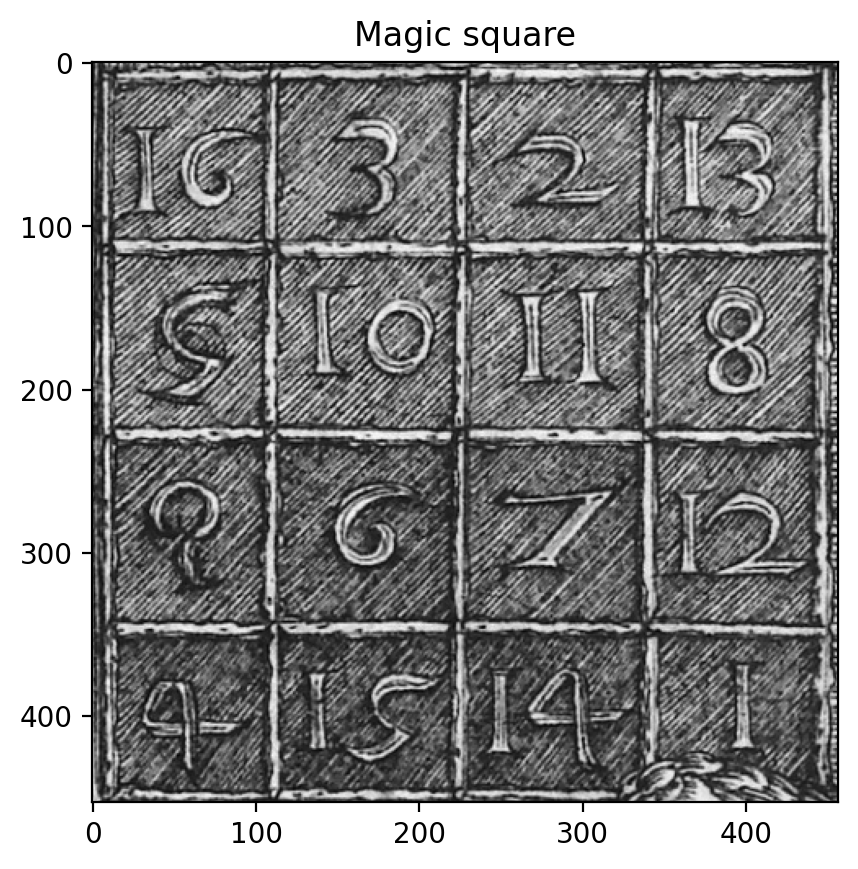

In [4]:
print('{}x{} pixel image'.format(m, n))
plt.imshow(data, cmap='gray')
plt.title('Magic square')
plt.show()

In [5]:
# data = U S V^T
U, S, Vt = np.linalg.svd(data)
print(U.shape)
print(Vt.shape)
print(S.shape)

(453, 453)
(457, 457)
(453,)


In [6]:
V = Vt.T

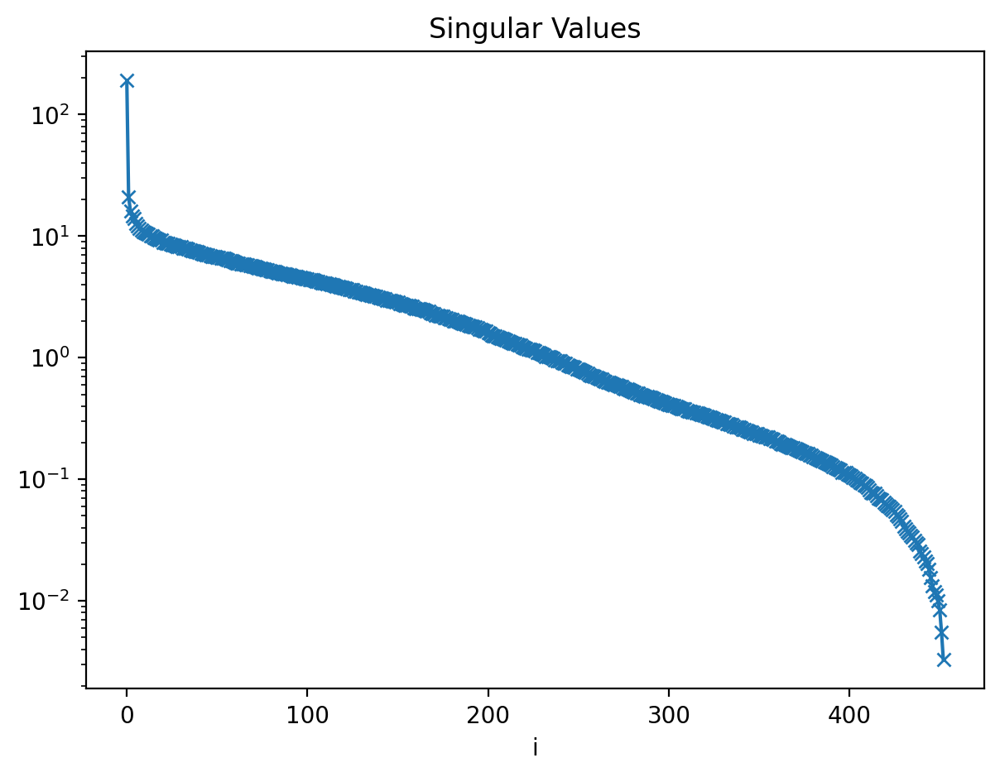

In [7]:
fig, ax = plt.subplots(figsize=(7, 5))
ax.semilogy(S, 'x-')
ax.set_title('Singular Values')
ax.set_xlabel('i')
plt.show()

## First 4 terms 

where term $i$ is the rank-1 matrix $\sigma_i\mathbf{u}_i\mathbf{v}_i^T$

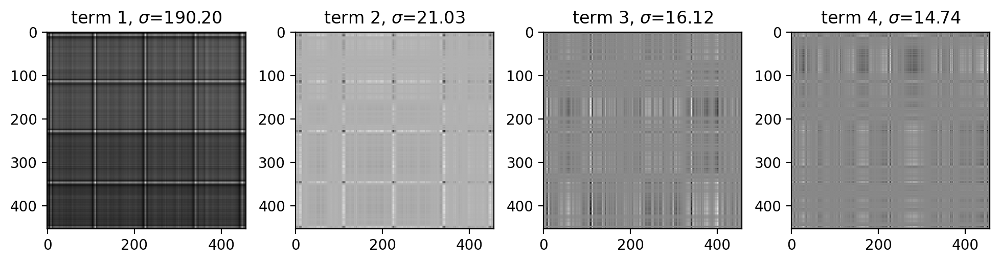

In [8]:
fig, axs = plt.subplots(1, 4, figsize=(12, 2.5))

for ii in range(4):
    ax = axs[ii]
    mode = S[ii] * np.outer(U[:, ii], V[:, ii])
    ax.imshow(mode, cmap='gray')
    ax.set_title(rf'term {ii+1}, $\sigma$={S[ii]:.2f}')
    
plt.show()

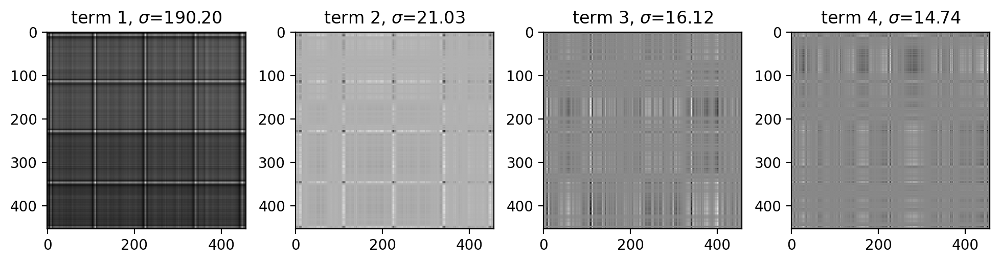

In [9]:
# using matrix mult instead of np.outer
# numpy does not really understand row and column vectors? Everything becomes a 1D array
fig, axs = plt.subplots(1, 4, figsize=(12, 2.5))

for ii in range(4):
    ax = axs[ii]
    mode = S[ii] * U[:, ii].reshape(-1, 1) @ V[:, ii].reshape(1, -1)
    ax.imshow(mode, cmap='gray')
    ax.set_title(rf'term {ii+1}, $\sigma$={S[ii]:.2f}')
    
plt.show()

## Compressed Reconstructions

We can now look at compressed reconstructions consisting of the first $k$ terms
$$
    A_k = \sum_{i=1}^k \sigma_i\mathbf{u}_i\mathbf{v}_i^T 
$$

the amount of memory required to store $A_k$ is $O(k(m +n + 1))$ whereas the storage of $A$ is $O(mn)$ so the relative compression is

$$
    \frac{k(m+n + 1)}{mn}
$$

The question is how many terms are required to adequately reconstruct the original image?
    

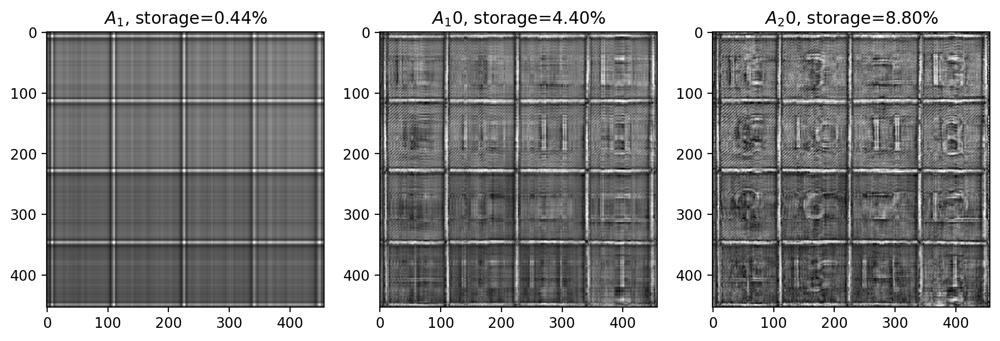

In [10]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
for ii, k in enumerate([1, 10, 20]):
    Ak = U[:, :k] @ np.diag(S[:k]) @ V[:, :k].T
    storage = 100. * k * (m + n + 1) / (m * n)
    ax = axs[ii]
    ax.imshow(Ak, vmin=0.0, vmax=1.0, cmap='gray')
    ax.set_title(rf'$A_{k}$, storage={storage:2.2f}%')
    
plt.show()

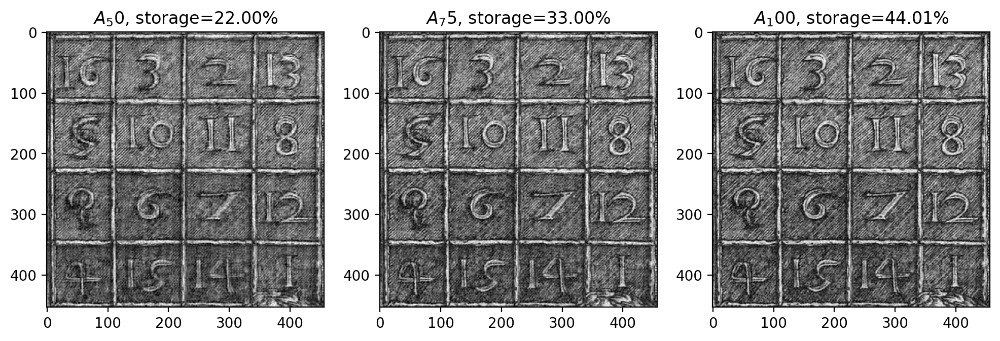

In [11]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
for ii, k in enumerate([50, 75, 100]):
    Ak = U[:, :k] @ np.diag(S[:k]) @ V[:, :k].T
    storage = 100. * k * (m + n + 1) / (m * n)
    ax = axs[ii]
    ax.imshow(Ak, vmin=0.0, vmax=1.0, cmap='gray')
    ax.set_title(rf'$A_{k}$, storage={storage:2.2f}%')
    
plt.show()

# Example: Principal Components Analysis (PCA)

Similar to the above example, except
- The data are a *sequence* of images
    - some reshaping required
- The average image is removed from the data
- There are statistical interpretations
    - e.g., orthogonal = uncorrelated

## Read sea surface temperature (SST) data

In [12]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

In [13]:
%%html
<iframe src="https://iridl.ldeo.columbia.edu/" width="1200" height="500"></iframe>

In [14]:
# Construct the url pointing to the data
# Sea surface temperature (SST) data 
dl_loc = 'SOURCES/.NOAA/.NCDC/.ERSST/.version5/.sst/'
# centered on the equator Y=latitude
region_str = 'Y/-30/30/RANGE/'
# November values
#time_str = 'T/(Jan%201950)/last/RANGE/T/(Nov)/VALUES/'
time_str = 'T/(Jan%201991)/last/RANGE/'
time_fix = 'T/(days%20since%201960-01-01)streamgridunitconvert/T/(Oct)/VALUES/'
sst_url = 'https://iridl.ldeo.columbia.edu/' + dl_loc + time_str + region_str + 'zlev/removeGRID/' + time_fix + '0/pop/dods'
sst_url

'https://iridl.ldeo.columbia.edu/SOURCES/.NOAA/.NCDC/.ERSST/.version5/.sst/T/(Jan%201991)/last/RANGE/Y/-30/30/RANGE/zlev/removeGRID/T/(days%20since%201960-01-01)streamgridunitconvert/T/(Oct)/VALUES/0/pop/dods'

In [15]:
# Open the dataset
sst_ds = xr.open_dataset(sst_url)
sst_ds

<xarray.Dataset> Size: 782kB
Dimensions:  (X: 180, Y: 31, T: 35)
Coordinates:
  * X        (X) float32 720B 0.0 2.0 4.0 6.0 8.0 ... 352.0 354.0 356.0 358.0
  * Y        (Y) float32 124B -30.0 -28.0 -26.0 -24.0 ... 24.0 26.0 28.0 30.0
  * T        (T) datetime64[ns] 280B 1991-10-16T12:00:00 ... 2025-10-16T12:00:00
Data variables:
    sst      (T, Y, X) float32 781kB ...
Attributes:
    Conventions:  IRIDL

## Plot some of it

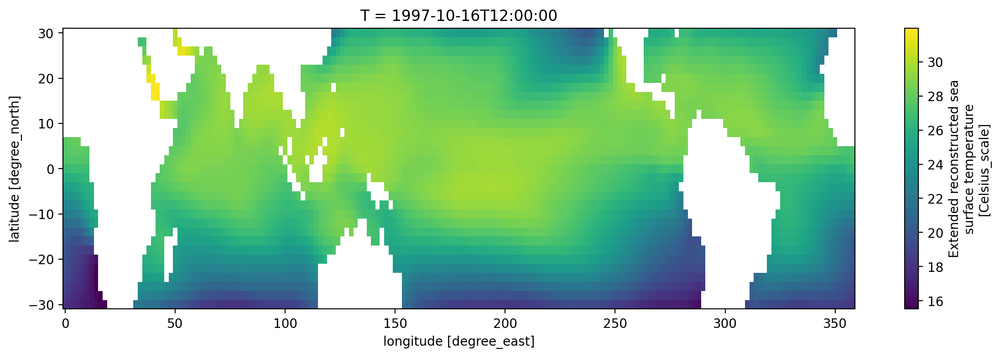

In [16]:
# Plot a value
sst_ds.sst.sel(T='1997').plot(figsize=(14, 4))
plt.show()

What do you see? Is it unusual?

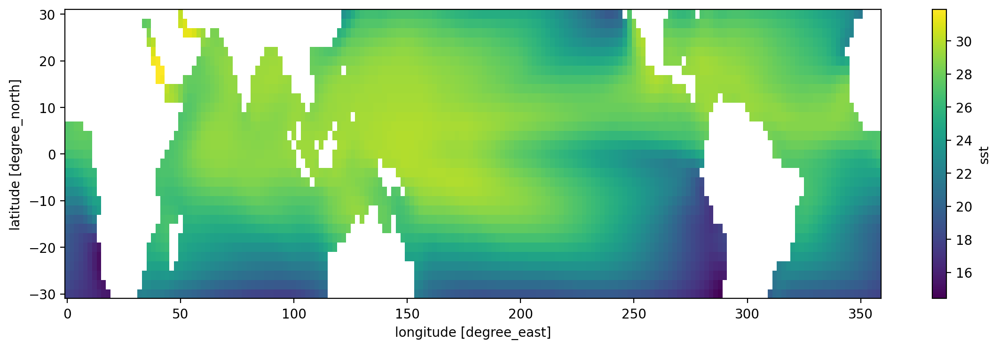

In [17]:
# Plot the average (mean) 1991-present
sst_ds.sst.mean('T').plot(figsize=(14, 4))
plt.show()

## Remove the mean

In [18]:
# Remove the mean. What's left is "anomalous"
ssta = sst_ds.sst - sst_ds.sst.mean('T')
ssta.name = 'sst anomaly'

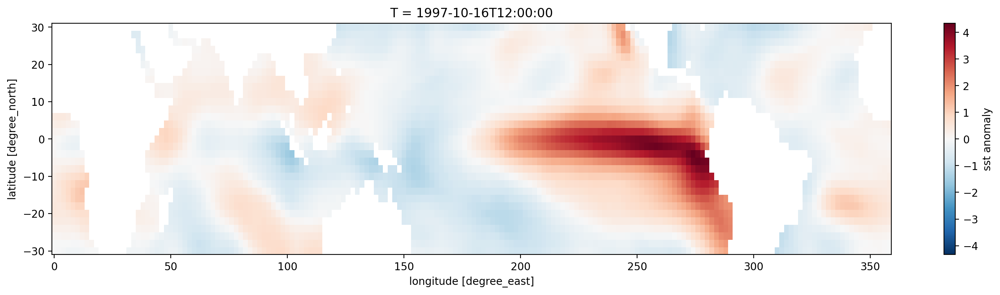

In [19]:
# Plot the 1997 anomaly
ssta.sel(T='1997').plot(figsize=(18, 4));

What do you see? Is it unusual?

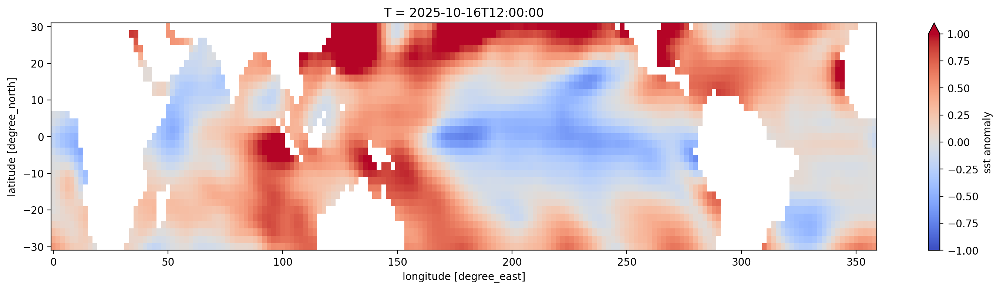

In [20]:
# Plot this year's value
ssta.sel(T='2025').plot(vmin=-1, vmax=1, cmap='coolwarm', figsize=(18, 4))
plt.show()

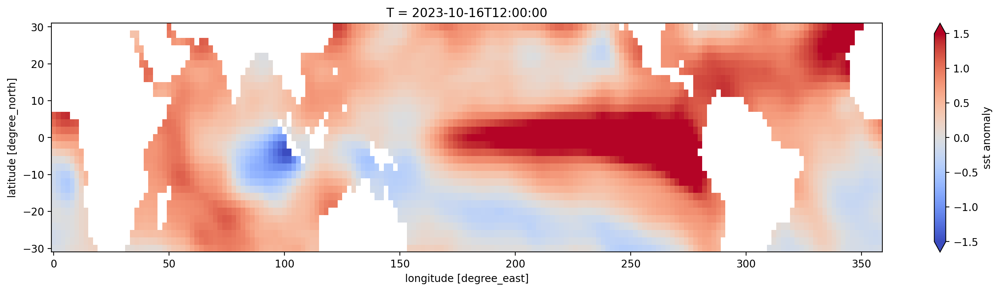

In [21]:
# Plot last year's value
ssta.sel(T='2023').plot(vmin=-1.5, vmax=1.5, cmap='coolwarm', figsize=(18, 4))
plt.show()

## Multi-dimensional data to 2D

Where is the matrix? Strategy
- Reshape each map into a column of $A$
-  SVD of $A$

### Stack

"Stack any number of existing dimensions into a single new dimension."

http://xarray.pydata.org/en/stable/generated/xarray.DataArray.stack.html

In [22]:
ssta2D = ssta.stack(YX=('Y', 'X'))
ssta2D

<xarray.DataArray 'sst anomaly' (T: 35, YX: 5580)> Size: 781kB
array([[-0.32009697, -0.32172394, -0.30615425, ...,         nan,
                nan,         nan],
       [-0.6687298 , -0.742054  , -0.7612705 , ...,         nan,
                nan,         nan],
       [ 0.9516468 ,  1.0024185 ,  0.97177315, ...,         nan,
                nan,         nan],
       ...,
       [-0.0747776 , -0.0579567 , -0.02363205, ...,         nan,
                nan,         nan],
       [ 0.45801163,  0.45711517,  0.43919754, ...,         nan,
                nan,         nan],
       [ 0.49531937,  0.43728828,  0.35690498, ...,         nan,
                nan,         nan]], shape=(35, 5580), dtype=float32)
Coordinates:
  * T        (T) datetime64[ns] 280B 1991-10-16T12:00:00 ... 2025-10-16T12:00:00
  * YX       (YX) object 45kB MultiIndex
  * Y        (YX) float32 22kB -30.0 -30.0 -30.0 -30.0 ... 30.0 30.0 30.0 30.0
  * X        (YX) float32 22kB 0.0 2.0 4.0 6.0 8.0 ... 352.0 354.0 356.0 358.0

In [23]:
ssta2D.shape, ssta.shape, 31 * 180

((35, 5580), (35, 31, 180), 5580)

In [24]:
year = ssta2D['T']

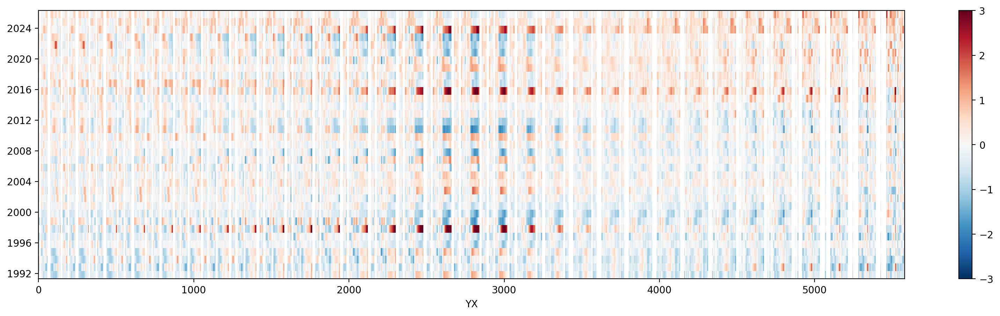

In [25]:
fig, ax = plt.subplots(figsize = (20, 5))
g = ax.pcolormesh(np.arange(len(ssta2D.YX)), year, ssta2D, cmap='RdBu_r', vmin=-3, vmax=3)
ax.set_xlabel('YX')
plt.colorbar(g)
plt.show()

what are the vertical white (missing values) lines?

In [26]:
# find the not missing
goodXY = ~np.isnan(ssta2D[0, :])

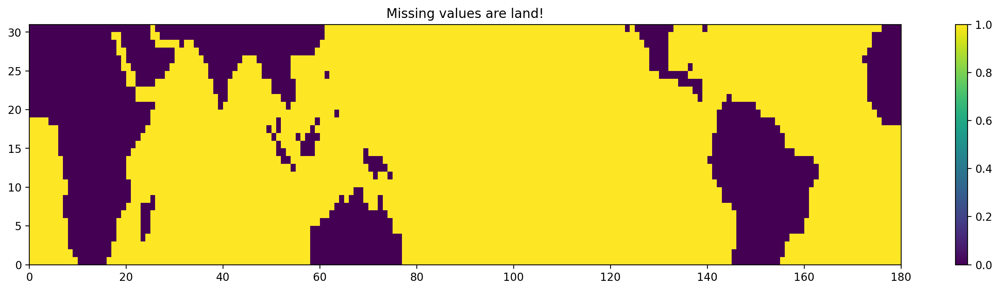

In [27]:
nt, ny, nx = ssta.shape
fig, ax = plt.subplots(figsize=(18, 4))
g = ax.pcolormesh(goodXY.values.reshape(ny, nx));
ax.set_title('Missing values are land!')
plt.colorbar(g)
plt.show()

Create a matrix that only has the non-missing values. SVD does not work missing values.

`.values` makes the xarray DataArray into a numpy array. 

In [28]:
dta = ssta2D.values[:, goodXY]
nt, nl = dta.shape

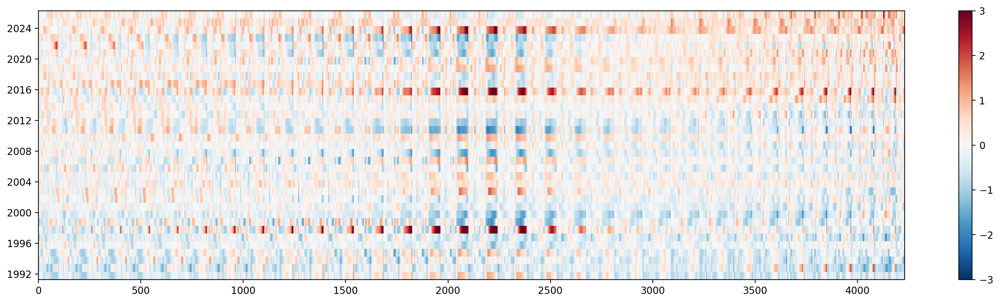

In [29]:
fig, ax = plt.subplots(figsize=(20, 5))
plt.pcolormesh(np.arange(nl), year, dta, cmap='RdBu_r', vmin=-3, vmax=3);
plt.colorbar()
plt.show()

In theory, one can have time vary along rows or columns. In practice, it is less confusing to choose a data model and stick with it. 

My mental image is that every column is a different time, which means that each row is *time series*, and we plot time series horizontally, like rows. Therefore, we take the transpose of `dta`.

## The matrix $A$

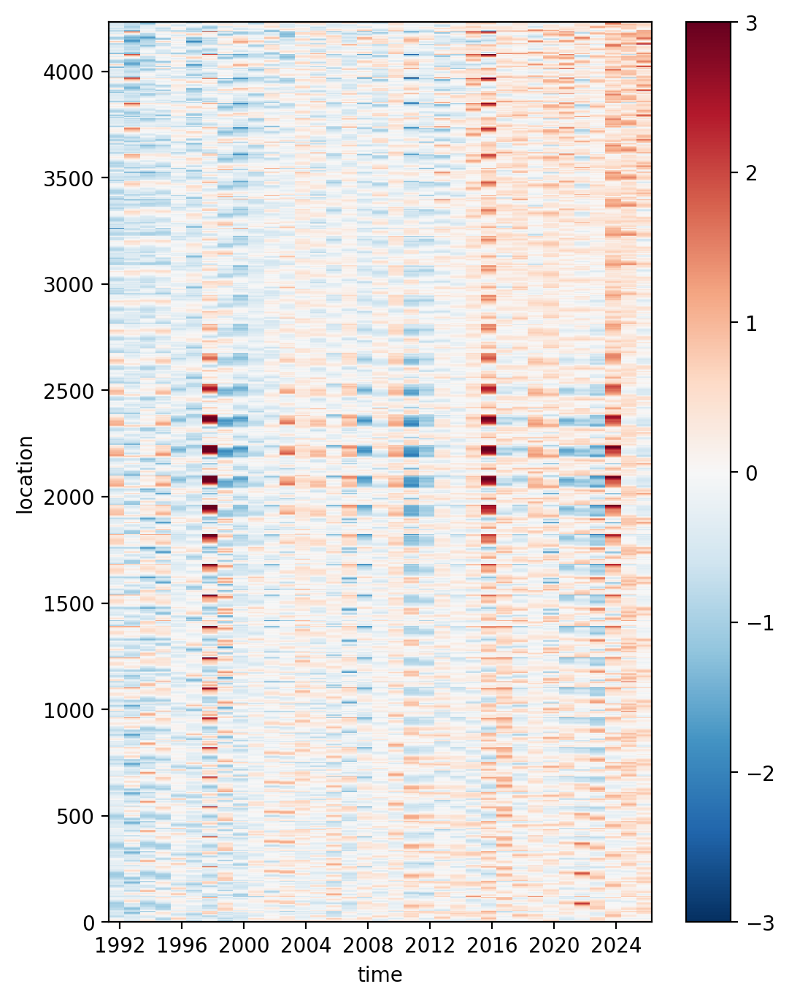

In [30]:
A = dta.T

fig, ax = plt.subplots(figsize=(6, 8))
g = ax.pcolormesh(year, np.arange(nl), A, cmap='RdBu_r', vmin=-3, vmax=3);
ax.set_xlabel('time')
ax.set_ylabel('location')
plt.colorbar(g)
plt.show()

In [31]:
# SVD
U, S, Vt = linalg.svd(A, full_matrices=False)
V = Vt.T

# save for later
S1 = S.copy()

In [32]:
# Check the size
# economy
print(U.shape)
print(V.shape)
print(S.shape)

(4231, 35)
(35, 35)
(35,)


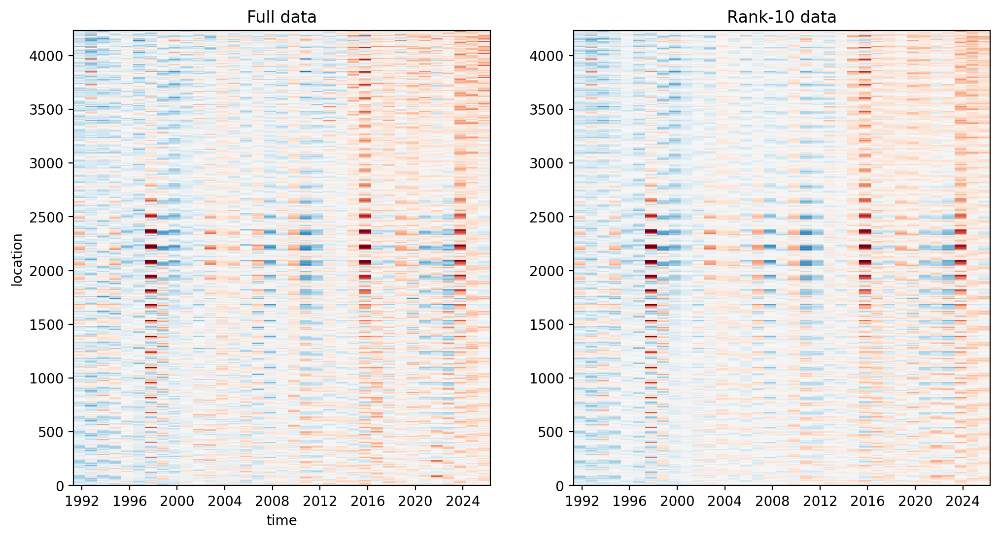

In [33]:
fig, axs = plt.subplots(1, 2, figsize = (12, 6))

# A = U S V^T
Asvd = U @ np.diag(S) @ V.T
ax = axs[0]
ax.pcolormesh(year, np.arange(nl), Asvd, cmap='RdBu_r', vmin=-3, vmax=3)
ax.set_xlabel('time')
ax.set_ylabel('location')

ax.set_title('Full data')

# A_k rank-k approximation
k = 10
A_approx = U[:, :k] @ np.diag(S[:k]) @ V[:, :k].T
ax = axs[1]
ax.pcolormesh(year, np.arange(nl), A_approx, cmap='RdBu_r', vmin=-3, vmax=3);
ax.set_title('Rank-10 data')
plt.show()

In [34]:
# put back the missing values for plotting as a map
ssta2D_approx = ssta2D.copy()
ssta2D_approx.values[:,goodXY] = A_approx.T
ssta_approx = ssta2D_approx.unstack('YX')

In [35]:
ssta_approx.shape

(35, 31, 180)

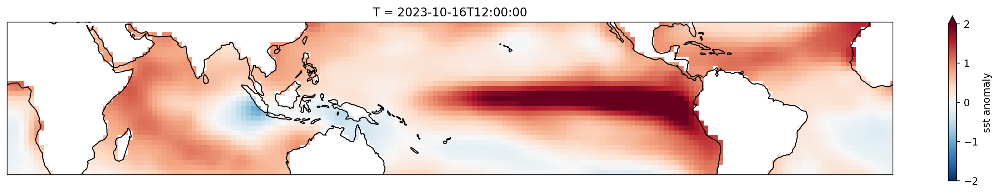

In [36]:
# plot the approximation
proj = ccrs.PlateCarree(central_longitude=180)
fig, ax = plt.subplots(1, 1, subplot_kw=dict(projection=proj), figsize=(20, 3))
ssta_approx.sel(T='2023').plot(ax=ax, vmin=-2, transform=ccrs.PlateCarree())
ax.coastlines()
plt.show()

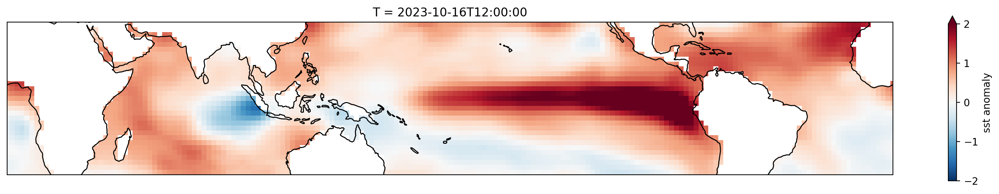

In [37]:
# plot the original
proj = ccrs.PlateCarree(central_longitude=180)
fig, ax = plt.subplots(1, 1, subplot_kw=dict(projection=proj), figsize=(20,3))
ssta.sel(T='2023').plot(ax=ax, vmin=-2, transform=ccrs.PlateCarree())
ax.coastlines()
plt.show()

## How good is the low-rank approximation?

The low-rank approximation:
$$ A_k = \sum_{i=1}^k \sigma_i u_i v_i^T \,.$$

No approximation:
$$ A = \sum_{i=1}^r \sigma_i u_i v_i^T \,.$$

The error of the approximation?
$$ A - A_k =  \sum_{i= k+1}^r \sigma_i u_i v_i^T$$

How big is the error (with units)?

$$ \| A - A_k \|^2_F = \sum_{i= k+1}^r \sigma_i ^2 $$

How big is the error (without units)?

Fraction of unexplained (by the PCA approximation) variance
$$ \frac{\| A - A_k \|^2_F}{\|A\|_F^2}$$

Fraction of explained (by the PCA approximation) variance
$$ 1 - \frac{\| A - A_k \|^2_F}{\|A\|_F^2} = 1 - \frac{\sum_{i= k+1}^r \sigma_i ^2}{\sum_{i=1}^r \sigma_i ^2} = \frac{\sum_{i= 1}^k \sigma_i ^2}{\sum_{i=1}^r \sigma_i ^2}$$



Ratios of sums of squares = fraction of variance

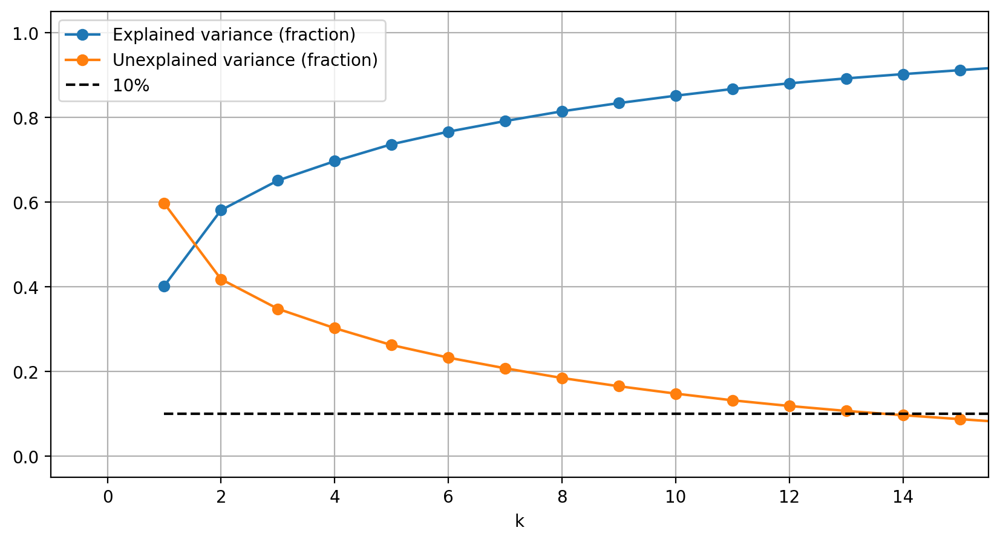

In [38]:
fig, ax = plt.subplots(figsize=(10, 5))

N = nt
Ns = np.arange(1, N + 1)
#plt.plot(Ns, S**2/np.sum(S**2), label ='?');
ax.plot(Ns, np.cumsum(S1**2) / np.sum(S1**2), '-o',  label='Explained variance (fraction)')
ax.plot(Ns, 1. - np.cumsum(S1**2) / np.sum(S1**2), '-o', label='Unexplained variance (fraction)')
ax.set_xlabel('k')
ax.plot(Ns, np.ones_like(Ns) * 0.1, 'k--', label='10%')
ax.legend()
ax.grid()
ax.set_xlim(-1, 15.5)
plt.show()

## Plotting

How to plot the terms (rank-1 matrices) in the sum? Three plots?

$$\sigma_i\,, u_i\,, v_i^T$$

Two?
$$(\sigma_i u_i)\,, v_i^T$$

Or two?
$$ u_i\,, (\sigma_i v_i^T)$$
Or what?

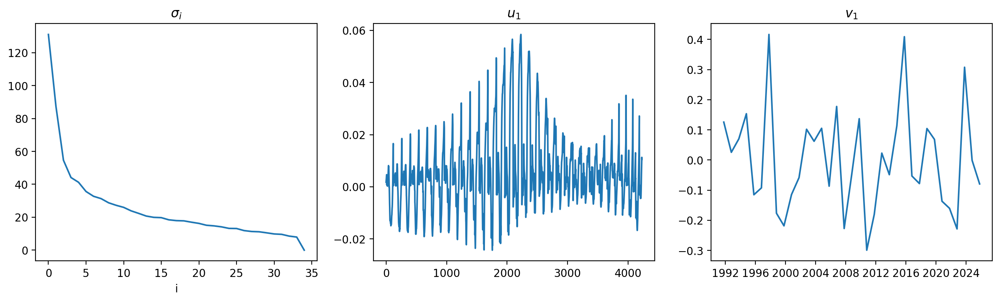

In [39]:
fig, axs = plt.subplots(1, 3, figsize=(16, 4))

ax = axs[0]
ax.plot(S)
ax.set_title(r'$\sigma_i$')
ax.set_xlabel('i')

ax = axs[1]
ax.plot(U[:,0]);
ax.set_title('$u_1$')


ax = axs[2]
ax.plot(sst_ds.T, V[:,0]);
ax.set_title('$v_1$');

What is the reason for the amplitude of the plots?

$v_i$ is a time series. It is handy to normalize it to have unit variance (instead of being a unit vector) and call it a *principle component*

$$ \text{PC}_i = \sqrt{N - 1} v_i $$
Why does this work?

Then what we take out of $v_i$ we put into the *empirical orthognal function* along with the singular value
$$ \text{EOF}_i = \sigma_i \frac{1}{\sqrt{N - 1}} u_i$$

Then 
$$\text{data} = A = \sum_{i=1}^r \text{EOF}_i \text{PC}_i $$

## Properties of PCs and EOFs
1. PCs are uncorrelated. Why?
    - Because $v_i$'s are orthogonal
2. EOFs are ...
    - orthogonal because $u_i$'s are orthogonal
3. The regression of a PC with the data is ...the EOF,  therefore EOFs are regression patterns
    - $U S V^T v_1$

In [40]:
# Nino 3.4
nino34_str = 'Y/-5/5/RANGEEDGES/X/190/240/RANGEEDGES%5BX/Y%5Daverage/'

n34_url = 'https://iridl.ldeo.columbia.edu/' + dl_loc + time_str + nino34_str + 'zlev/removeGRID/' + time_fix + 'dods'

n34_ds = xr.open_dataset(n34_url)
n34a = n34_ds.sst.groupby('T.month') - n34_ds.sst.groupby('T.month').mean('T')

## Plotting EOFs and PCs

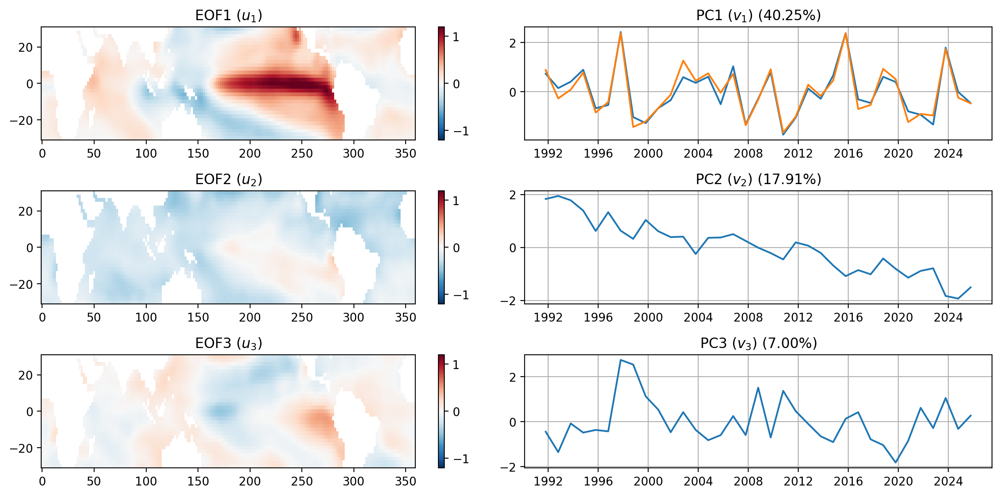

In [41]:
X = sst_ds.X
Y = sst_ds.Y
T = sst_ds.T

# k = number of EOFs to look at
k = 3

# EOFs are for plotting and have the dimensions original maps (with missing values)
EOFs = np.zeros((ny * nx, k)) + np.nan
EOFs[goodXY,:] = U[:, 0:k] / np.sqrt(nt - 1) @ np.diag(S[0:k])
EOFs = EOFs.reshape([ny, nx, k])

PCs = np.zeros((nt, k)) + np.nan
PCs[:,:] = V[:, 0:k] * np.sqrt(nt - 1)

VarExp = S**2 / np.sum(S**2)

fig, axes = plt.subplots(k, 2, figsize=(12, 2*k))
for ii in range(0,k):
    g = axes[ii,0].pcolormesh(X, Y, EOFs[:, :, ii], cmap='RdBu_r', vmin=-1.2, vmax=1.2, shading='auto')
    plt.colorbar(g,ax=axes[ii, 0])
    axes[ii,1].plot(T, PCs[:, ii])
    axes[ii,1].set_title('PC{0} ($v_{0}$) ({1:2.2f}%)'.format(ii + 1, 100 * VarExp[ii]))
    axes[ii,1].grid()
    axes[ii,0].set_title('EOF{0} ($u_{0}$)'.format(ii + 1))
plt.tight_layout()
fig.set_facecolor("white")

axes[0, 1].plot(T, n34a);

## What is ENSO?

El Niño–Southern Oscillation (ENSO)

In [42]:
%%html
<iframe src="https://www.climate.gov/news-features/blogs/enso/what-el-ni%C3%B1o%E2%80%93southern-oscillation-enso-nutshell" width="1200" height="600"></iframe>

# Line fitting by least squares and total least squares

## (Ordinary) least squares

### Generate data

(APMA 4300 example)

We start by constructing a random data set that approximates a straight line with random errors in y

In [43]:
# npoints uniformly randomly distributed points in the interval [0,3]
npoints = 100
xtrue = np.random.uniform(0., 3., npoints)
# set y = mx + b plus random noise of size err
slope = 1.0
intercept = 1.0
err = 0.5
# the TRUTH
ytrue = slope * xtrue + intercept 

### Fit line

In [44]:
# add some random noise to ytruth
y = ytrue + np.random.normal(scale=err, size=npoints)

# least squares fit
# NOT a great idea computationally
A = np.array([ np.ones(xtrue.shape), xtrue]).T
ls_fit = inv(A.T @ A) @ (A.T @ y)
intercept_ls = ls_fit[0]
slope_ls = ls_fit[1]
print(ls_fit)
A[:5, :]

[0.94294346 1.02147367]


array([[1.        , 0.96669996],
       [1.        , 0.04928377],
       [1.        , 0.86435625],
       [1.        , 1.93716249],
       [1.        , 1.56865083]])

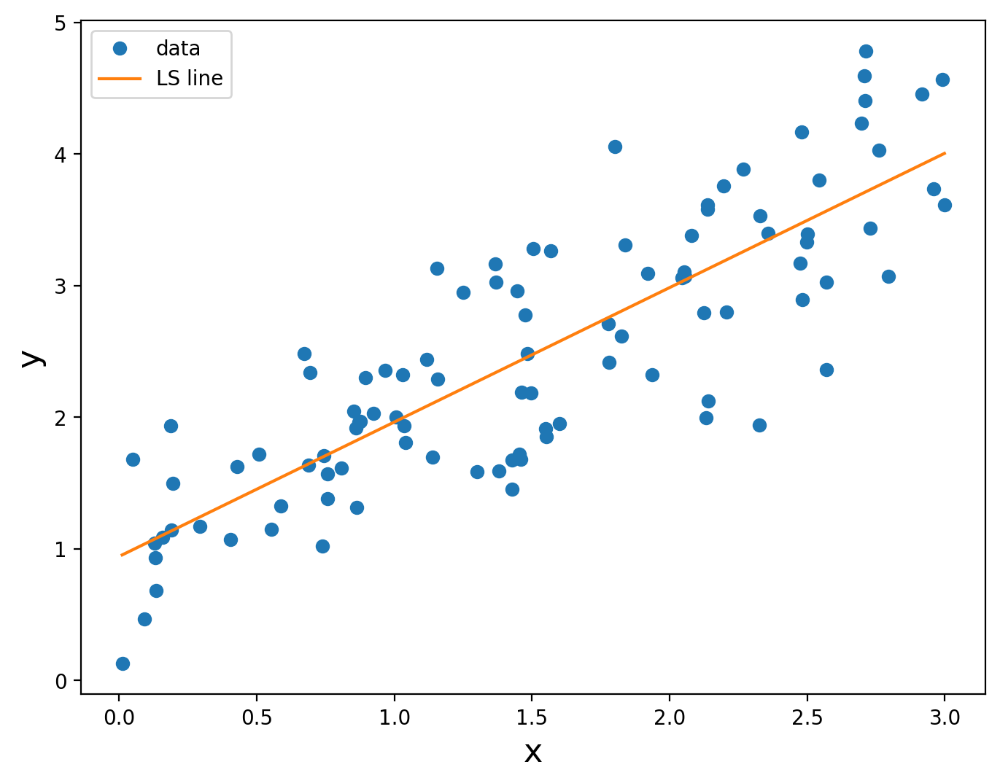

In [45]:
# And plot 
x_plot = np.array([xtrue.min(), xtrue.max()])

fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(xtrue, y, 'o', label='data')
ax.plot(x_plot, slope_ls * x_plot + intercept_ls, label='LS line')
ax.set_xlabel('x', fontsize=16)
ax.set_ylabel('y', fontsize=16)
ax.legend()
plt.show()

In some sense the slope is correct on average. (If the experiment were repeated many times)

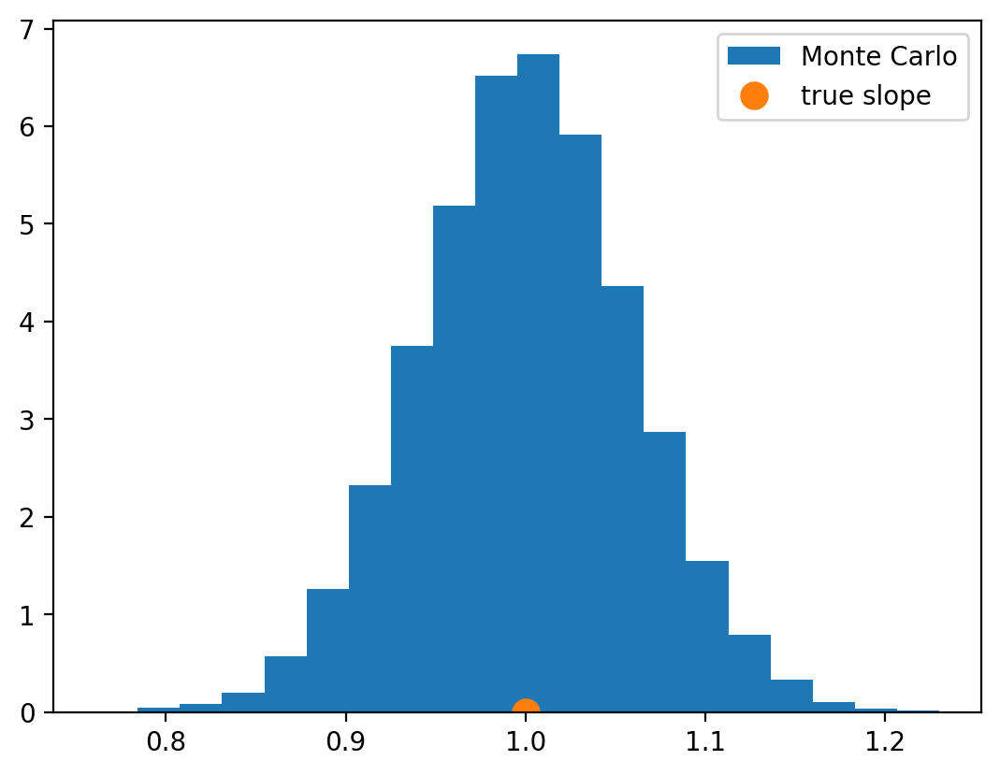

In [46]:
# Monte Carlo 
mc = 10000

slope_ls_mc = np.full(mc, np.nan)
for ii in range(mc):
    # add some random noise to ytruth
    y = ytrue + np.random.normal(scale=err, size=npoints)
    
    # least squares fit
    # NOT a great idea computationally
    A = np.array([ np.ones(xtrue.shape), xtrue]).T
    ls_fit = inv(A.T @ A) @ (A.T @ y)
    slope_ls_mc[ii] = ls_fit[1]

plt.hist(slope_ls_mc, bins=20, density=True, label='Monte Carlo')
plt.plot(slope, 0.0, 'o', markersize=10, label='true slope')
plt.legend()
plt.show()

You learn in a stats class how to put error bars on the estimated slope

## Total least squares

What happens if y *and* x have errors?

### Generate data

We start by constructing a random data set that approximates a straight line with random errors in y

### Fit line

In [47]:
# add some random noise to ytruth
y = ytrue + np.random.normal(scale=err, size=npoints)

# add some random noise to ytruth
x = xtrue + np.random.normal(scale=err, size=npoints) #<--------------

# least squares fit
# NOT a great idea computationally
A = np.array([ np.ones(x.shape), x]).T #<--------------
ls_fit = inv(A.T @ A) @ (A.T @ y)
intercept_ls = ls_fit[0]
slope_ls = ls_fit[1]
print(ls_fit)
A[:5, :]

[1.41172163 0.77764843]


array([[ 1.        ,  0.78231706],
       [ 1.        , -0.87288206],
       [ 1.        ,  1.11191571],
       [ 1.        ,  1.50033177],
       [ 1.        ,  2.23556684]])

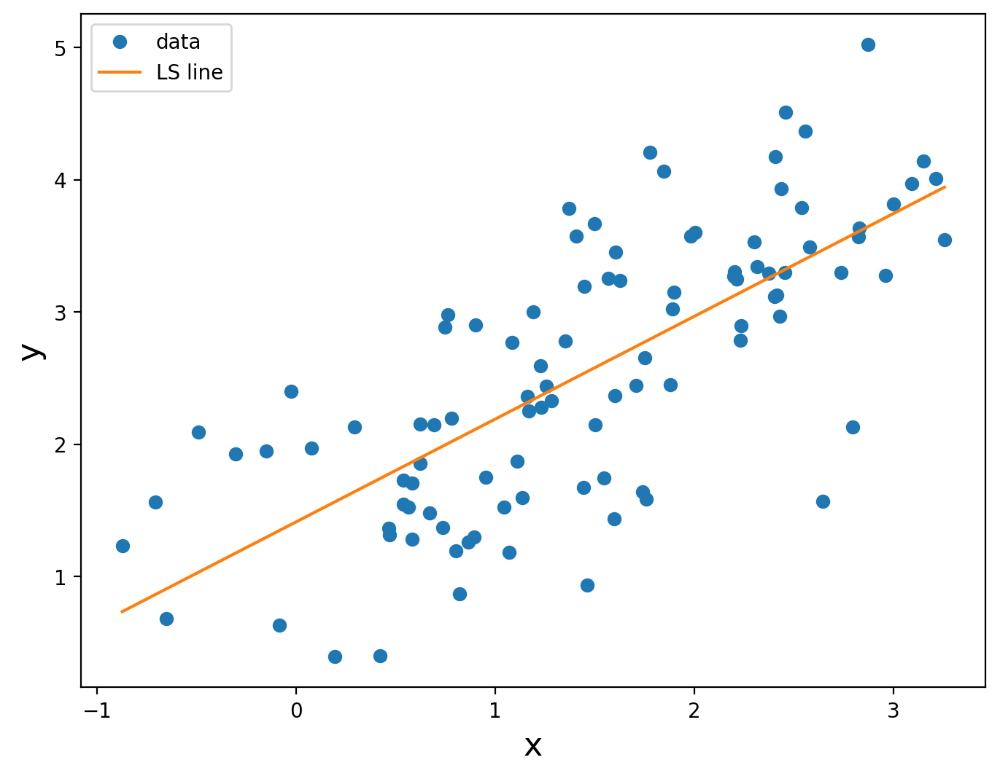

In [48]:
# And plot 
x_plot = np.array([x.min(), x.max()])

fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(x, y, 'o', label='data')
ax.plot(x_plot, slope_ls * x_plot + intercept_ls, label='LS line')
ax.set_xlabel('x', fontsize=16)
ax.set_ylabel('y', fontsize=16)
ax.legend()
plt.show()

Is the slope is correct on average? (If the experiment were repeated many times)

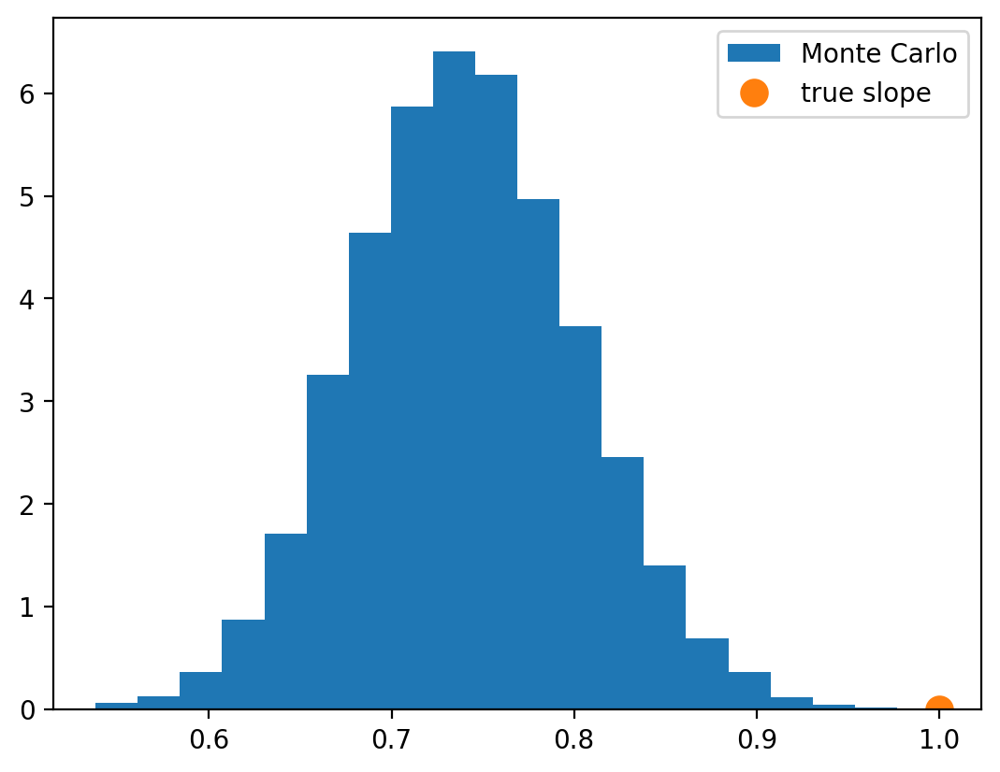

In [49]:
# Monte Carlo 
mc = 10000

slope_ls_mc = np.full(mc, np.nan)
for ii in range(mc):
    # add some random noise to ytruth
    y = ytrue + np.random.normal(scale=err, size=npoints)
    # add some random noise to xtruth
    x = xtrue + np.random.normal(scale=err, size=npoints) #<--------------
    
    # least squares fit
    # NOT a great idea computationally
    A = np.array([ np.ones(x.shape), x]).T #<--------------
    ls_fit = inv(A.T @ A) @ (A.T @ y)
    slope_ls_mc[ii] = ls_fit[1]

plt.hist(slope_ls_mc, bins=20, density=True, label='Monte Carlo')
plt.plot(slope, 0.0, 'o', markersize=10, label='true slope')
plt.legend()
plt.show()

The slope is biased low.

In some sense the term in the denominator is too large
$$ \text{slope} = \frac{\sigma_{xy}}{\sigma_x^2} $$

### 3 distances to the fit line

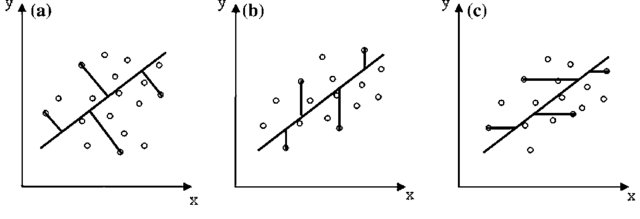

In [50]:
Image(filename='images/Schematic-illustration-of-a-orthogonal-regression-b-standard-least-squares-regression-c_W640.jpg', width=700)
#reference DOI: 10.1007/s11069-010-9531-8

(a) Perpendictular distance to line is minimized. Both $x$ and $y$ values are adjusted. Total least squares

(b) Vertical distance to line is minimized. Only $y$ values are adjusted. Ordinary least squares

(c) Horizontal distance to line is minimized. Only $x$ values are adjusted. Reverse regression

### Solution by SVD (general)

Least squares finds the $\hat{x}$ that minimizes

$$\| A \hat{x} - b\|^2 $$

The idea is that the quantity $b$ *should* be a linear combination of the columns of $A$ but the values of $b$ that we have contain measurement errors. That is, for some unknown $x_{true}$, $b_{true} = A x_{true}$, and what we measure is $b = b_{true} + error$. Given our measurement $b$, we can compute our least-squares estimate $\hat{x}$.

In the context of line fitting, minimizing $$\| A \hat{x} - b\|^2$$ means minimizing the *vertical* distance between the fit line and the data ($b$).

Total least squares minimizes the total (perpendictular) distance between the line and the data ($b$). The squared total distance is the sum of the squared vertical distance plus the squared horizontal distance.

$$ \text{total distance} = \| \hat{A} \hat{x} - b\|^2 + \|\hat{A}  - A\|^2_F $$ 

Recall that $A$ contains the "x" coordinates and $b$ contains the "y" coordinates. $\hat{A}$ contains the adjusted "x" coordinates.

Equivalently, 

$$ \text{total distance}  = \| \hat{A} \hat{x} - b\|^2 + \|\hat{A}  - A\|^2_F = \| [\hat{A} - A, \hat{A} \hat{x} - b] \|^2_F = \| W - Z \|_F^2$$ 

where $W = [\hat{A}, \hat{A} \hat{x}]$ and $Z = [A, b]$. $Z$ contains quantities that we measure, and $W$ contains quantities that are unknown and must be estimated.

Can we solve the TLS problem by choosing $W = Z$? 

No. Assuming that the $n$ columns of $A$ are linearly independent, and that $Ax = b$ has no solution, the rank of $Z$ is $n+1$. On the other hand, the rank of $W$ is at most $n$ because its last column is a linear combination of its first $n$ columns. 

The best choice for $W$ is the rank-$n$ approximation of $Z$, which can be computed using the SVD $Z = U \Sigma V^T$ as

$$ W = \sum_{i=1}^n \sigma_i u_i v_i^T $$

Fine, but what is the TLS solution $\hat{x}$?

By construction $v_{n+1}$ is in the null space of $W$ and $W v_{n+1} = 0$ because perpendictular to all the other $v$'s.

Denote the $n$-th component of $v_{n+1}$ by $\alpha$ and assume $\alpha \neq 0$. Then $\hat{x}$ is related to $v_{n+1}$ by

$$ v_{n+1} = \alpha \begin{bmatrix} \hat{x} \\ -1 \end{bmatrix}, $$

which is directly verified by

$$ W v_{n+1} = [\hat{A}, \hat{A} \hat{x} ] \begin{bmatrix*}[r] \hat{x} \\ -1 \end{bmatrix*} =
\hat{A} \hat{x} - \hat{A} \hat{x}  = 0.$$

### Solution by SVD (line fit)

Special case of above with $n=1$. $A$ has one column because the columns of 1s is measured without error.

The equation of the line (no intercept) is: $y = s x$

Given data $\mathbf{x}$ and $\mathbf{y}$, find
- the slope $s$
- adjusted $\hat{\mathbf{x}}$ and $\hat{\mathbf{y}}$
so that the perpendictular distance $\|\mathbf{x} - \hat{\mathbf{x}}\|^2 + \|\mathbf{y} - \hat{\mathbf{y}}\|^2$ is minimized and where $\hat{\mathbf{y}} = s\hat{\mathbf{x}}$.

$$ \|\mathbf{x} - \hat{\mathbf{x}}\|^2 + \|\mathbf{y} - \hat{\mathbf{y}}\|^2 = \|\mathbf{x} - \hat{\mathbf{x}}\|^2 + \|\mathbf{y} - s\hat{\mathbf{x}}\|^2 =
\left\| \begin{bmatrix} \mathbf{x} & \mathbf{y} \end{bmatrix} - \begin{bmatrix} \hat{\mathbf{x}} & s \hat{\mathbf{x}} \end{bmatrix} \right\|_F^2$$
Since the second matrix is rank-1 (why?), the best we can do is $\left\| A - A_1 \right\|^2$, where $A_1$ is the best rank-1 approxiamtion of $A$.

But, we really just want the slope $s$. Note that $\begin{bmatrix} \hat{\mathbf{x}} & s \hat{\mathbf{x}} \end{bmatrix} \begin{bmatrix*}[r] s \\ -1 \end{bmatrix*} = \vec{0}$. This means that $\begin{bmatrix*}[r] s \\ -1 \end{bmatrix*}$ is in the null space which means it is a multiple of $\mathbf{v}_2$ which means

$$ s = - \frac{\mathbf{v}_{2,1}}{\mathbf{v}_{2,2}} $$



### Solution by SVD (line fit)
(a recipe from APMA 4300)

* form a matrix $M$ whose rows are the de-meaned data (BECAUSE the constant term is NOT measured with error)
* find the SVD of $M = U\Sigma V^T$, 
* set $\mathbf{u} = \mathbf{v}_2$ 
* and in 2-D,  the best fit line is parallel to $\mathbf{v}_1$ and goes through the mean of the data

In [51]:
# Prepare the data matrix
X = np.array([x , y]).T
print('Shape of data Matrix: {}'.format(X.shape))

Shape of data Matrix: (100, 2)


In [52]:
# and remove the mean
X_mean = np.mean(X, 0)
print('Mean of data matrix={}'.format(X_mean))
M = X - X_mean

Mean of data matrix=[1.51445991 2.46113285]


In [53]:
# now calculate the SVD of the de-meaned data matrix
U, S, VT = np.linalg.svd(M, full_matrices=False)
V = VT.T
print('Singular values = {}'.format(S))
print('First Right singular vector V_1= {}'.format(V[:,0]))

Singular values = [13.24637347  4.65840101]
First Right singular vector V_1= [0.66411928 0.74762664]


Now plot and compare the two solutions

0.7776484285485622
1.12574150831755


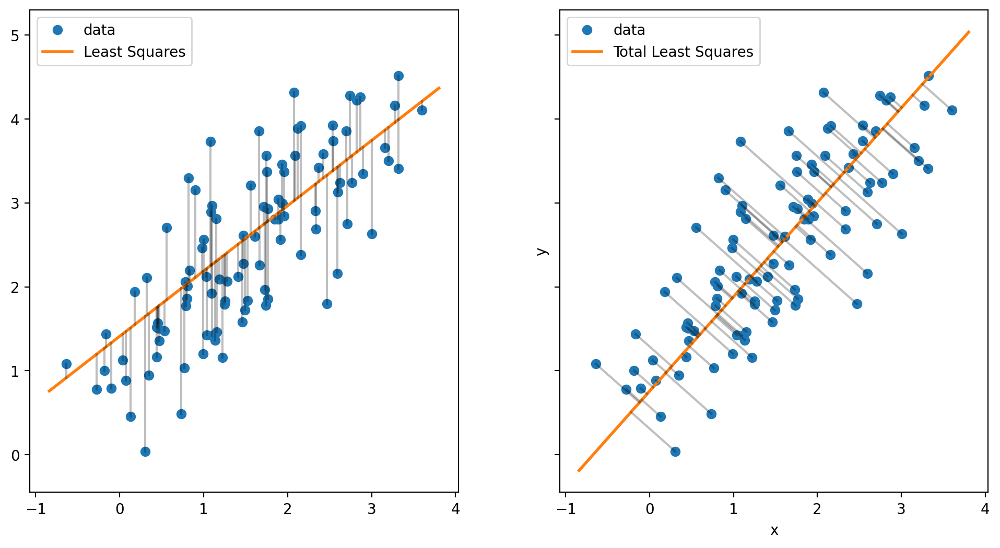

In [54]:
# dummy variables 
t_ls = np.linspace(x.min() - 0.2, x.max() + 0.2)
#t_svd =  2*(t_ls - np.mean(t_ls))

# make figure
fig, axs = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(12, 6))

ax = axs[0]
ax.plot(x, y, 'o', label='data')
# plot the least squares solution
ax.plot(t_ls, intercept_ls + slope_ls * t_ls, linewidth=2, label='Least Squares')
for ii in range(npoints):
    ax.plot(x[ii]*np.array((1, 1)), np.array((y[ii], intercept_ls + slope_ls * x[ii])), color='k', alpha=0.25)
ax.legend(loc='upper left')
print(slope_ls)
# plot the total least Squares solution
# plot the mean
# plt.plot(X_mean[0],X_mean[1],'go', markersize=12, label='X_mean')
# calculate a line through the mean with the first principal component as a basis
#L_tls = X_mean + np.outer(t_svd,V[:,0])
#plt.plot(L_tls[:,0],L_tls[:,1],'c-',label='Total Least Squares')

ax = axs[1]
W = S[0] * np.outer(U[:, 0], V[:, 0]) 
x_tls = W[:, 0]
tls_slope = -V[0, -1]/V[1, -1]
ax.plot(x, y, 'o', label='data')
ax.plot(t_ls,  tls_slope * (t_ls - x.mean()) + y.mean(), linewidth=2, label='Total Least Squares')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend(loc='upper left')
print(tls_slope)

for ii in range(npoints):
    tls_line_x = x_tls[ii] + x.mean() 
    tls_line_y = tls_slope * x_tls[ii] + y.mean() 
    ax.plot(np.array((x[ii], tls_line_x)), np.array((y[ii], tls_line_y)), color='k', alpha=0.25)

ax.set_aspect(1, share=True)

plt.show()

Not a huge difference?

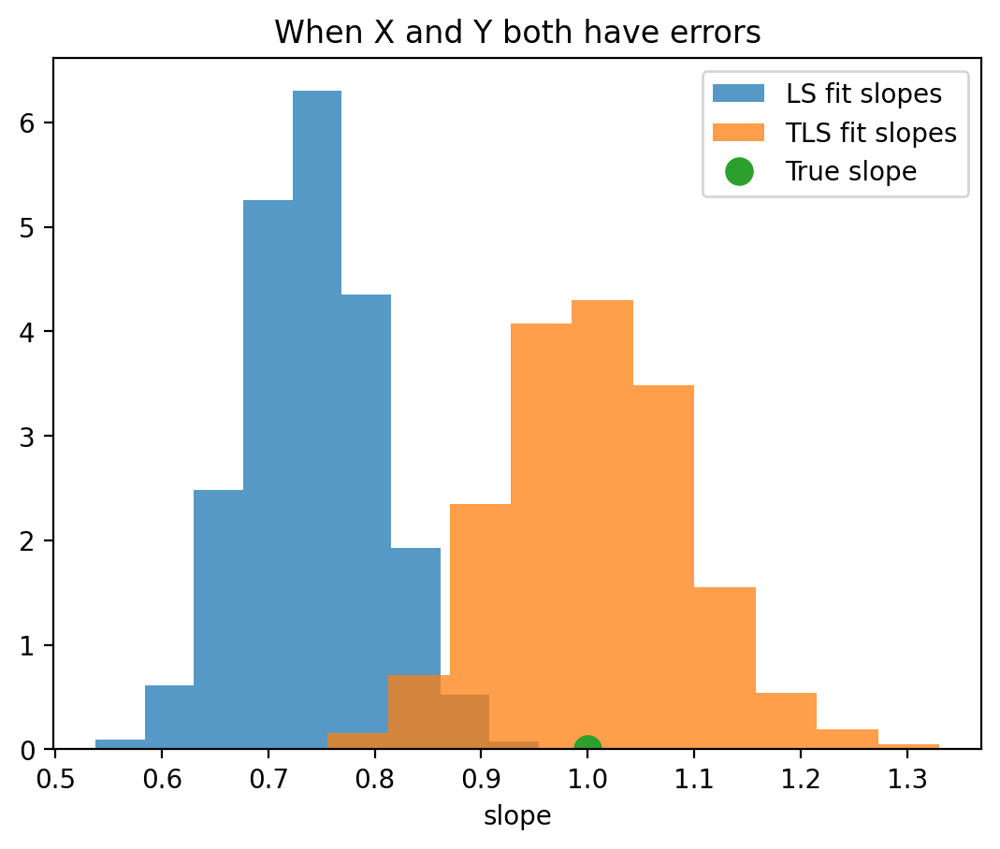

In [55]:
mcmax = 1000
slope_tls = np.empty(mcmax)
for ii in range(mcmax):
    # add some random noise to ytrue
    y = ytrue + np.random.normal(scale=err, size=npoints)

    # add some random noise to xtrue
    x = xtrue + np.random.normal(scale=err, size=npoints)

    # Prepare the data matrix
    X = np.array([x , y]).T
    # and remove the mean
    X_mean = np.mean(X, 0)
    M = X - X_mean
    # now calculate the SVD of the de-meaned data matrix
    U, S, VT = np.linalg.svd(M, full_matrices=False)
    V = VT.T
    
    slope_tls[ii] = -V[0, -1]/V[1, -1]
    
plt.hist(slope_ls_mc, density=True, label='LS fit slopes', alpha=0.75)
plt.hist(slope_tls, density=True, label='TLS fit slopes', alpha=0.75)
plt.plot(slope, 0, 'o', ms=10, label='True slope')
plt.xlabel('slope')
plt.legend()
plt.title('When X and Y both have errors')
plt.show()

LS is biased *and* underestimates the uncertainty.